In [161]:
import numpy as np
import matplotlib.pyplot as plt
import healpy as hp
from astropy.io import fits
from astropy.utils.data import get_pkg_data_filename
import functions as f
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format ='retina'

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


#### Importing the Planck15 Raw CMB data from https://irsa.ipac.caltech.edu/data/Planck/release_2/all-sky-maps/

In [162]:
CMB_map_names = ["LFI_SkyMap_030_1024_R2.01_full.fits",
                 "LFI_SkyMap_044_1024_R2.01_full.fits" ,
                 "LFI_SkyMap_070_1024_R2.01_full.fits",
                 "HFI_SkyMap_100_2048_R2.02_full.fits", 
                 "HFI_SkyMap_143_2048_R2.02_full.fits",
                 "HFI_SkyMap_217_2048_R2.02_full.fits", 
                 "HFI_SkyMap_353_2048_R2.02_full.fits", 
                 "HFI_SkyMap_545_2048_R2.02_full.fits", 
                 "HFI_SkyMap_857_2048_R2.02_full.fits",];

In [114]:
CMB_maps = []
for i in CMB_map_names:
    
    temp = hp.read_map("../CMB_maps/%s"%(i))
    temp2 = hp.pixelfunc.ud_grade(temp, 512, order_in='RING') #to have the same resolution for all maps
    CMB_maps.append((10**6)*temp2)

NSIDE = 1024
ORDERING = NESTED in fits file
INDXSCHM = IMPLICIT
Ordering converted to RING
NSIDE = 1024
ORDERING = NESTED in fits file
INDXSCHM = IMPLICIT
Ordering converted to RING
NSIDE = 1024
ORDERING = NESTED in fits file
INDXSCHM = IMPLICIT
Ordering converted to RING
NSIDE = 2048
ORDERING = NESTED in fits file
INDXSCHM = IMPLICIT
Ordering converted to RING
NSIDE = 2048
ORDERING = NESTED in fits file
INDXSCHM = IMPLICIT
Ordering converted to RING
NSIDE = 2048
ORDERING = NESTED in fits file
INDXSCHM = IMPLICIT
Ordering converted to RING
NSIDE = 2048
ORDERING = NESTED in fits file
INDXSCHM = IMPLICIT
Ordering converted to RING
NSIDE = 2048
ORDERING = NESTED in fits file
INDXSCHM = IMPLICIT
Ordering converted to RING
NSIDE = 2048
ORDERING = NESTED in fits file
INDXSCHM = IMPLICIT
Ordering converted to RING


#### Raw data maps for all 9 frequencies


0.0 180.0 -180.0 180.0
The interval between parallels is 30 deg -0.00'.
The interval between meridians is 30 deg -0.00'.
0.0 180.0 -180.0 180.0
The interval between parallels is 30 deg -0.00'.
The interval between meridians is 30 deg -0.00'.
0.0 180.0 -180.0 180.0
The interval between parallels is 30 deg -0.00'.
The interval between meridians is 30 deg -0.00'.
0.0 180.0 -180.0 180.0
The interval between parallels is 30 deg -0.00'.
The interval between meridians is 30 deg -0.00'.
0.0 180.0 -180.0 180.0
The interval between parallels is 30 deg -0.00'.
The interval between meridians is 30 deg -0.00'.
0.0 180.0 -180.0 180.0
The interval between parallels is 30 deg -0.00'.
The interval between meridians is 30 deg -0.00'.
0.0 180.0 -180.0 180.0
The interval between parallels is 30 deg -0.00'.
The interval between meridians is 30 deg -0.00'.
0.0 180.0 -180.0 180.0
The interval between parallels is 30 deg -0.00'.
The interval between meridians is 30 deg -0.00'.
0.0 180.0 -180.0 180.0
The inter

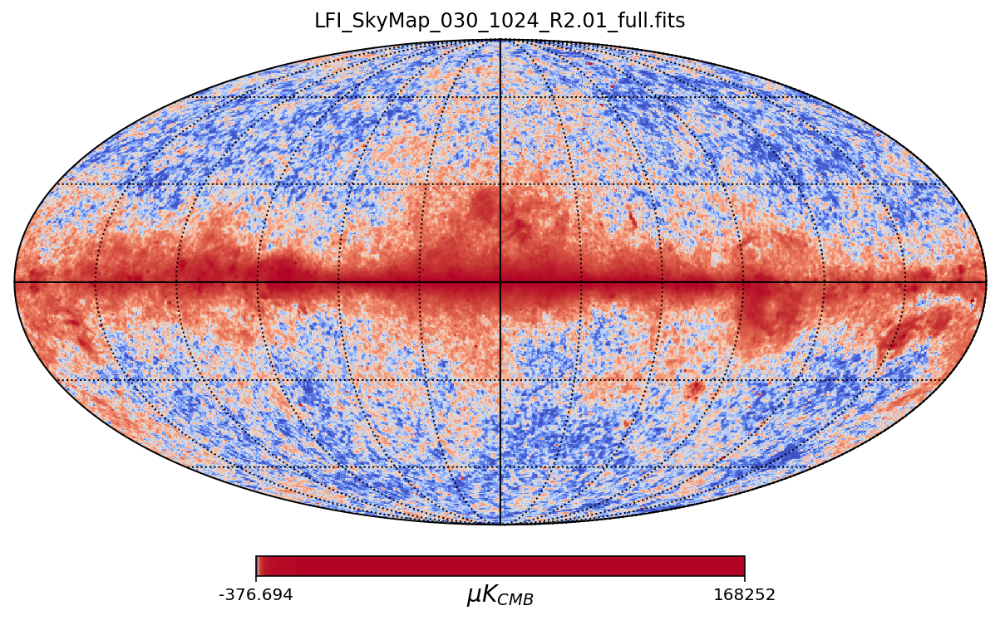

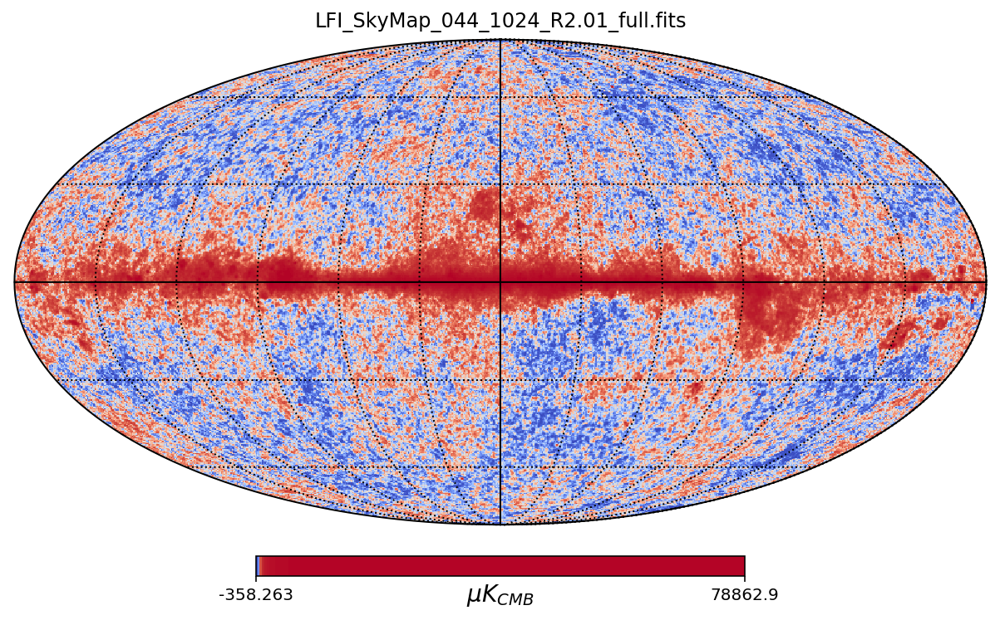

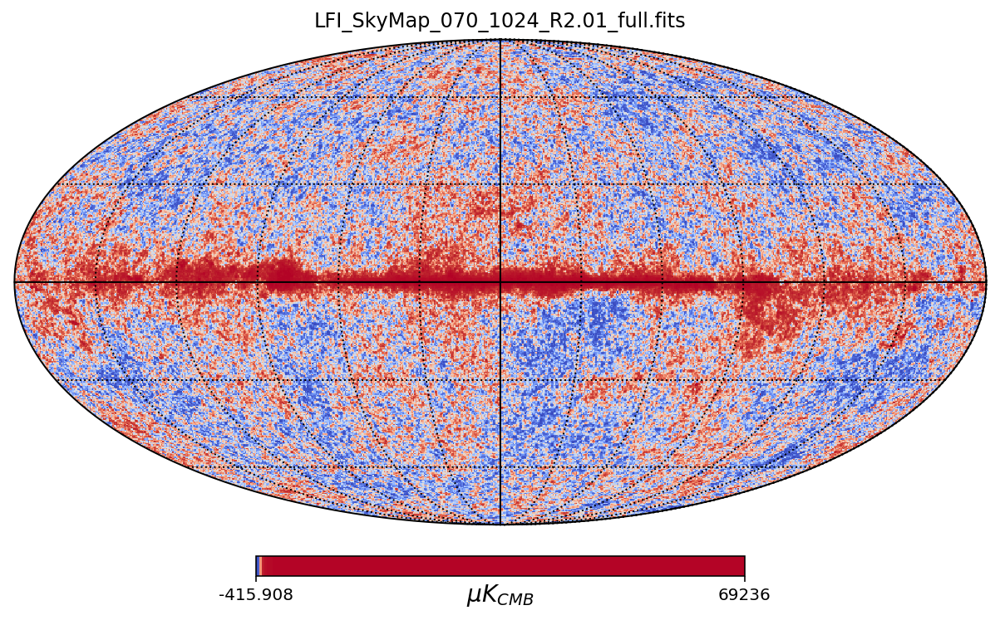

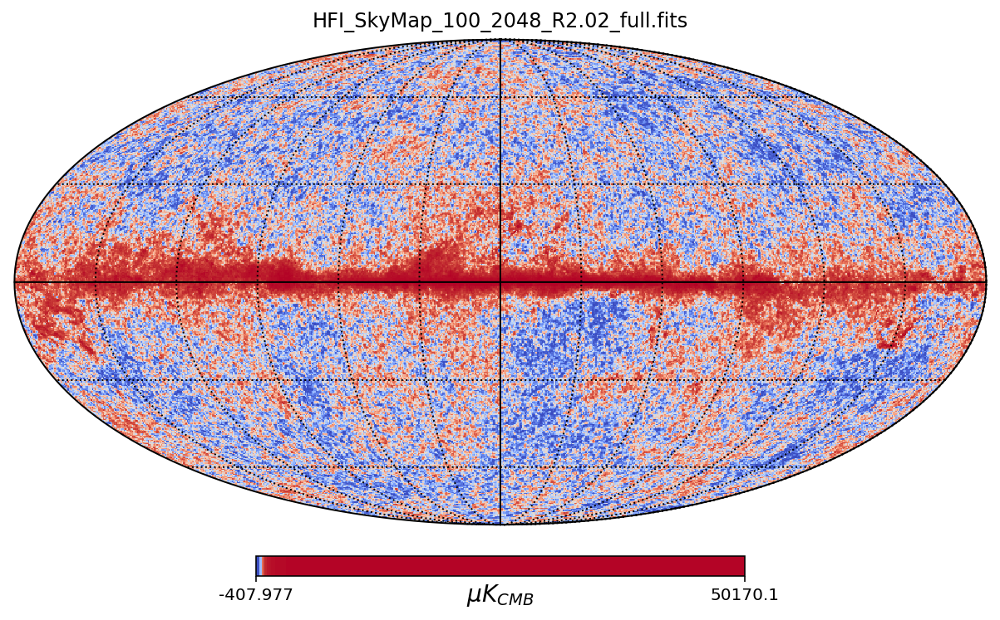

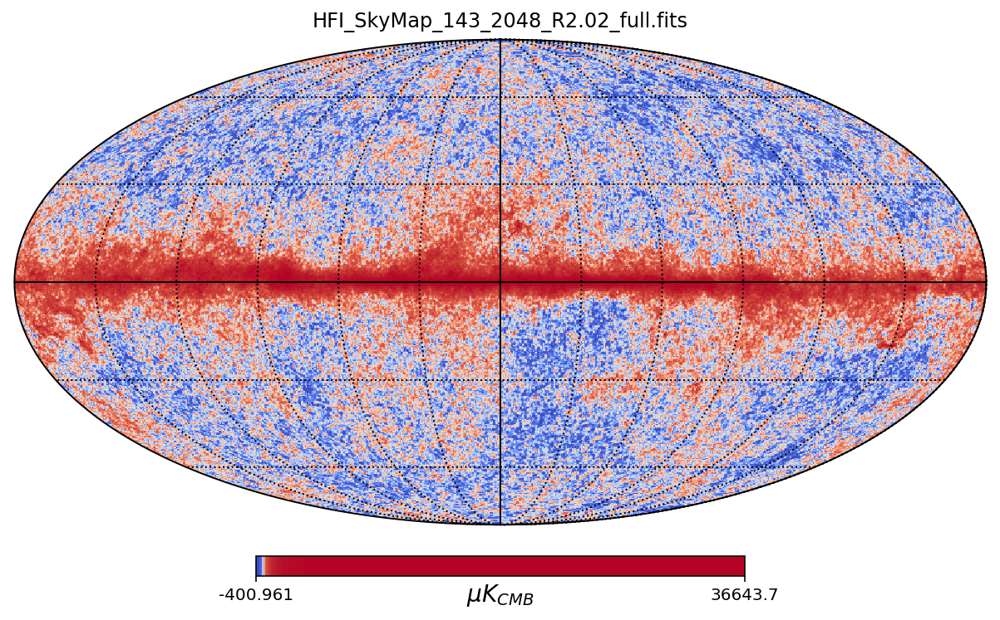

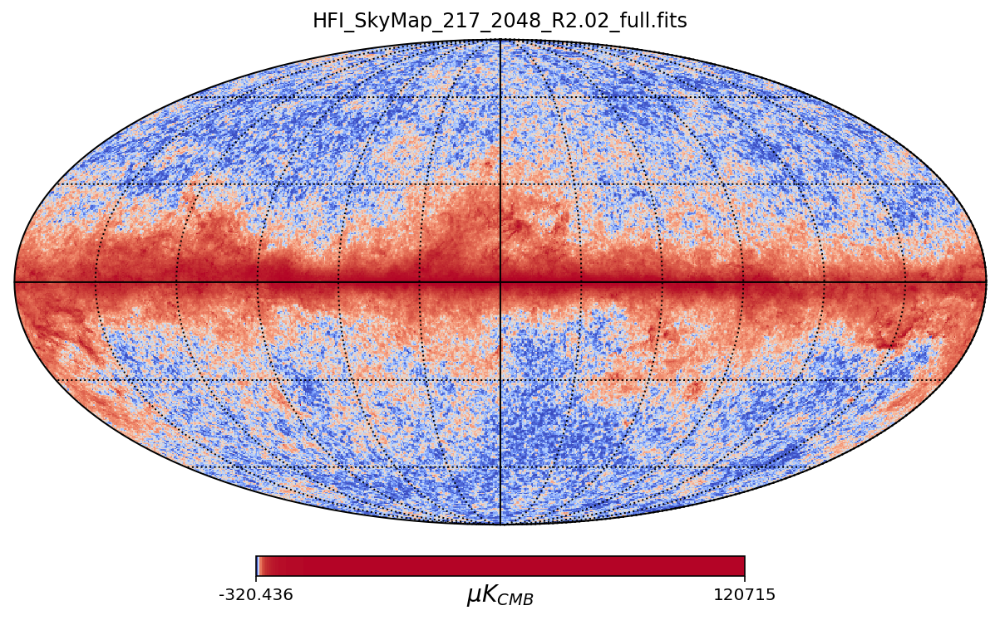

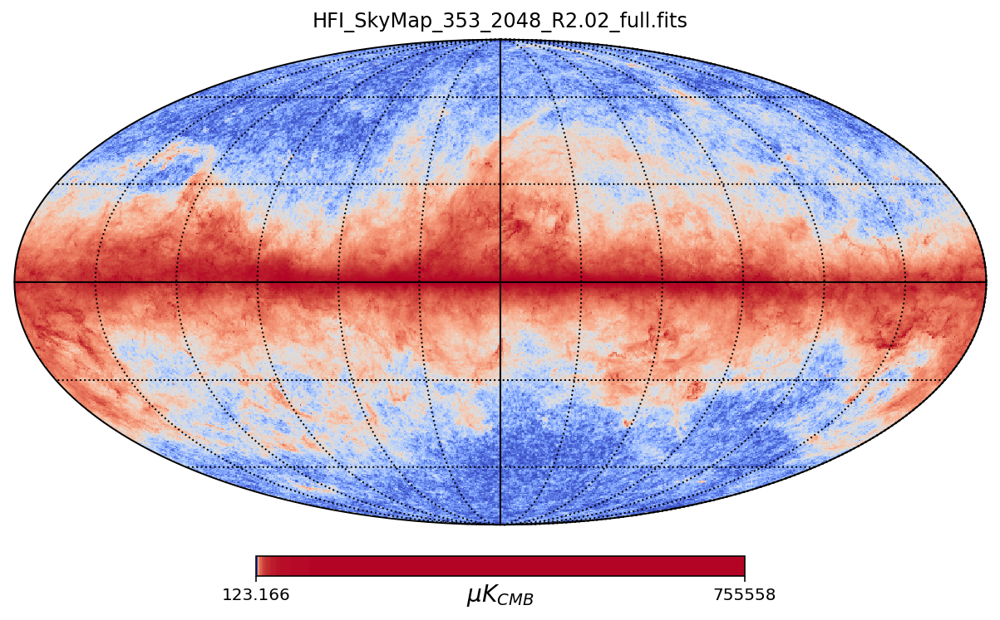

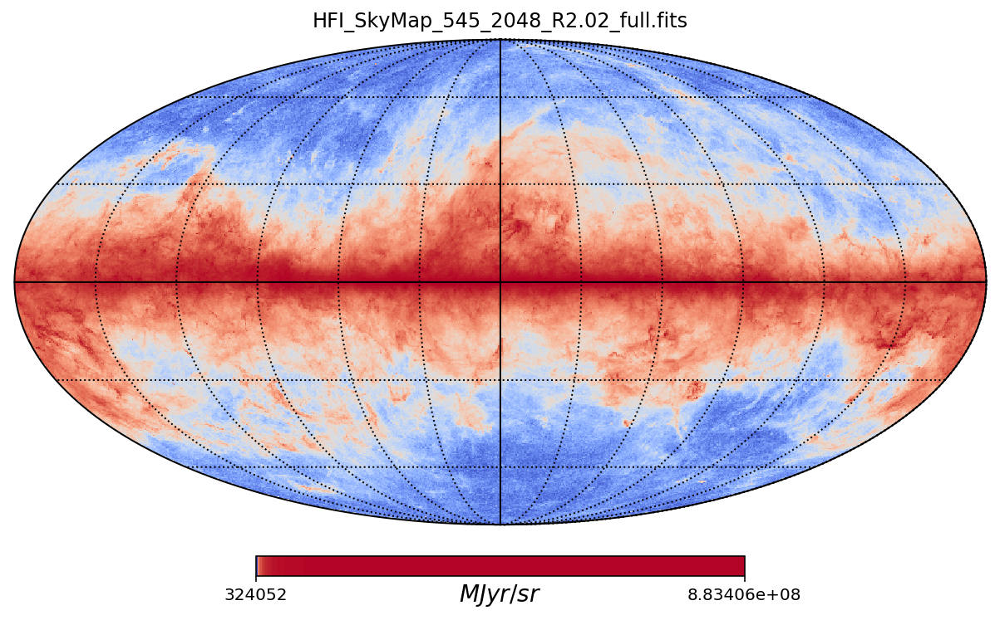

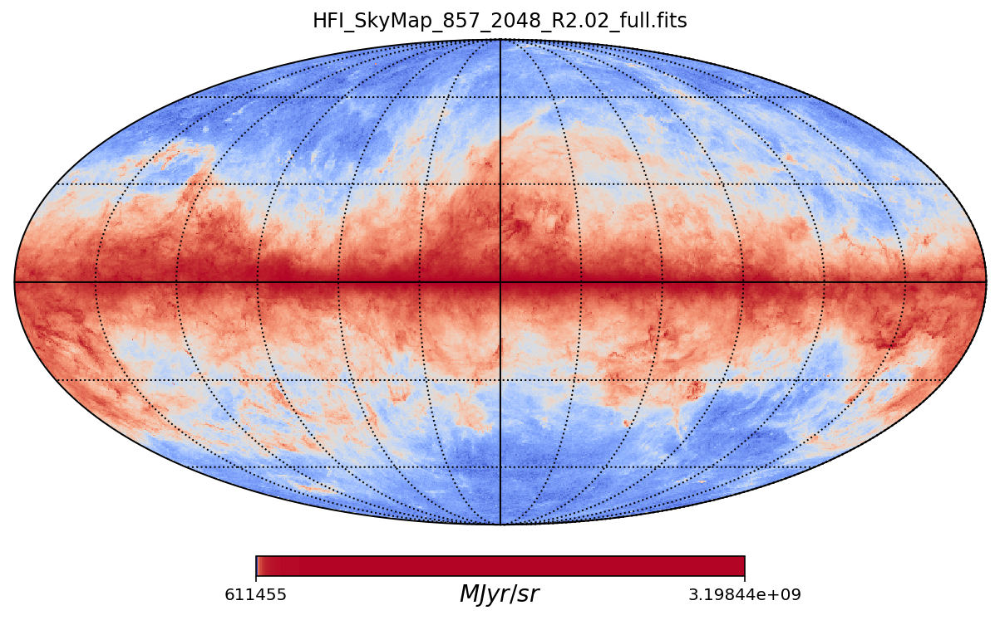

In [115]:
u = r"$\mu K_{CMB}$"
u2 = r"$MJyr/sr$"
for i in range(len(CMB_maps)):
    if i < 7 :
        hp.mollview(CMB_maps[i], unit= u ,norm="hist", title=CMB_map_names[i], cmap = 'coolwarm'
                 #min=-1,
                 #max=1,
                 )
    else: 
        hp.mollview(CMB_maps[i], unit= u2 ,norm="hist", title=CMB_map_names[i], cmap = 'coolwarm'
                 #min=-1,
                 #max=1,
                 )
        
    hp.graticule()


## Data Analysis
#### First, a few important things:
the signal is given in different units depending on the band : "The signal is given in units of Kcmb for 30-353 GHz, or MJy/sr (for a constant νFν energy distribution ) for 545 and 857 GHz." Hence we need to convert the 2 highest bands to the units $K_{cmb}$.

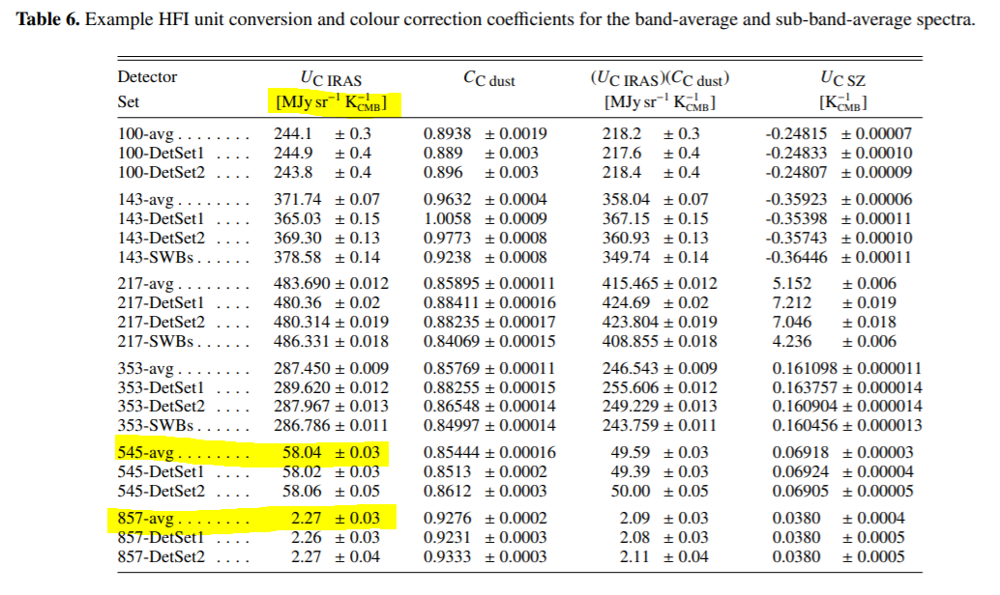

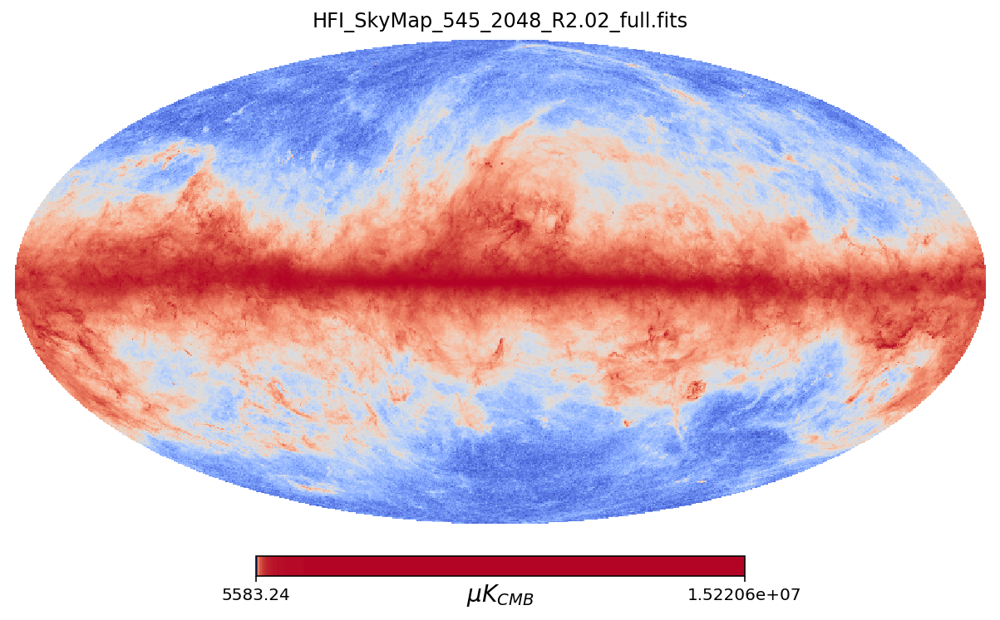

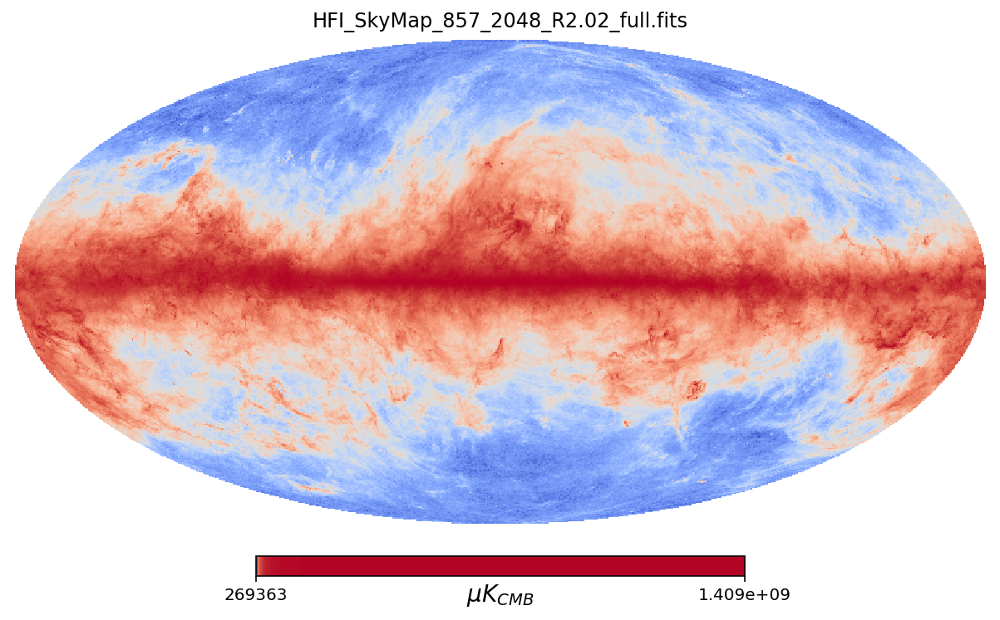

In [116]:
# the diff frequencies
freq = [30,44,70,100,143,217,353,545,857]

#the HFI where not obtained in the same units as the LFI, there exist some conversion factors:
conv_factors = [1/58.04,1/2.27]

CMB_maps_cor =[]
for i in range(2):
    #convert
    CMB_maps_cor.append(conv_factors[i]*CMB_maps[7+i])

    #visualize
    hp.mollview(CMB_maps_cor[i], unit = u ,norm="hist", title=CMB_map_names[i+7], cmap = 'coolwarm'
                 #min=-1,
                 #max=1,
                 )


In [117]:
#doing Tegmark paper's determination of regions
#step 1
%autoreload 2
CMB_maps[7] = CMB_maps_cor[0]
CMB_maps[8] = CMB_maps_cor[1]

diff_maps = []
for i in range(len(CMB_maps)-1):
    diff_maps.append(CMB_maps[i]-CMB_maps[1+i])
    
#step 2
abs_diff_maps = np.abs(np.transpose(diff_maps))
junk_map = np.array([np.max(i) for i in abs_diff_maps])

#code to downsample the junk_map
#junk_map = hp.pixelfunc.ud_grade(junk_map, 64)
#junk_map = hp.pixelfunc.ud_grade(junk_map, 512)

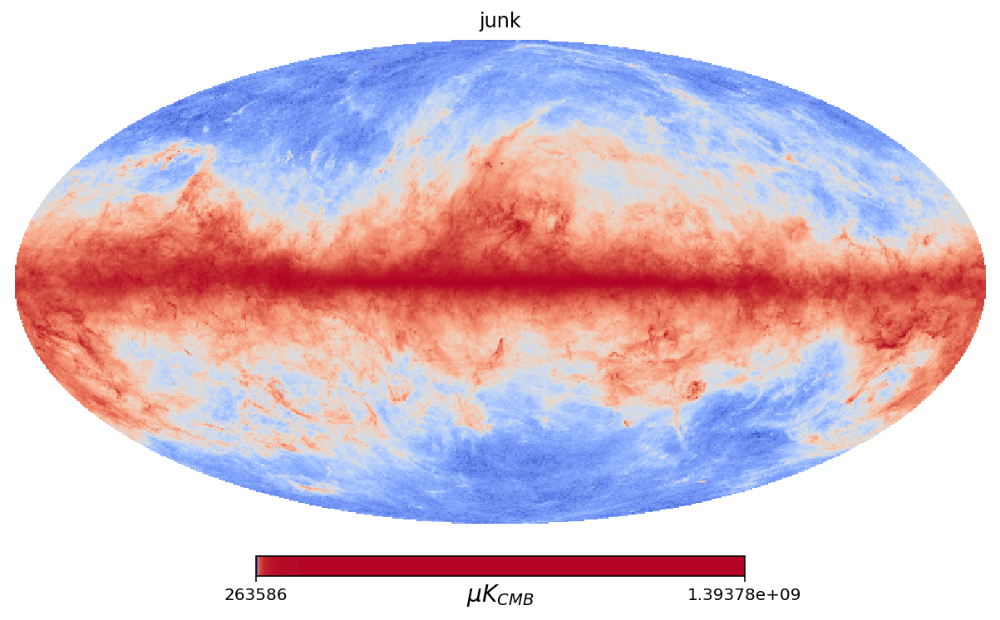

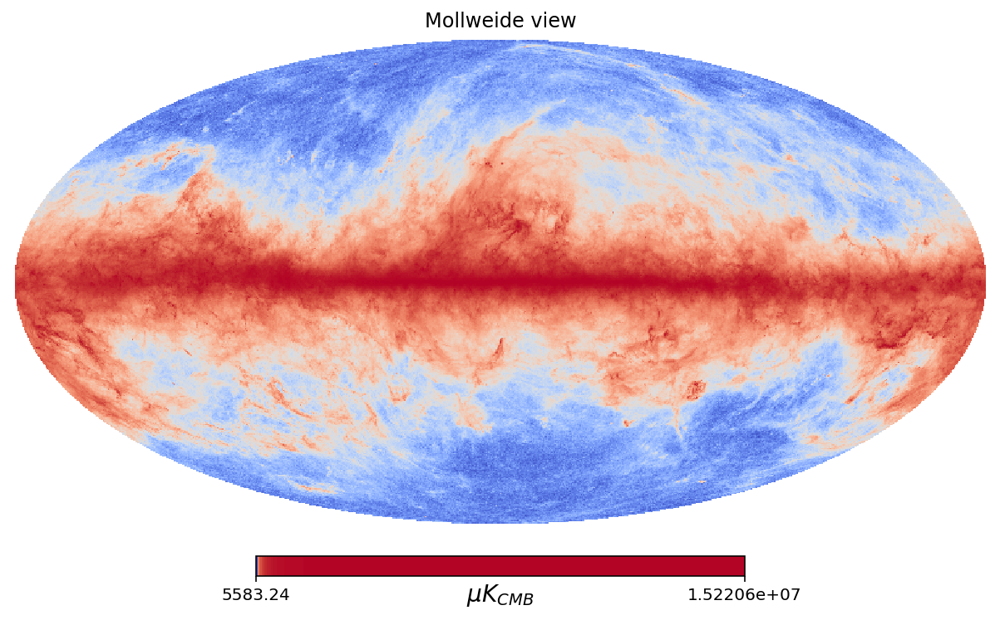

In [118]:
#comparing junk map to 800-band map
hp.mollview( junk_map, unit= u ,norm="hist", title='junk', cmap = 'coolwarm'
                 #min=-1,
                 #max=1,
                 )
hp.mollview( (CMB_maps_cor[1] - junk_map), unit= u ,norm="hist", cmap = 'coolwarm'
                 #min=-1,
                 #max=1,
                 )

### Region Finding (based on junk map)

the bin edges aka regions [2.53674752e+05 6.76377932e+05 1.80343966e+06 4.80854628e+06
 1.28211206e+07 3.41852036e+07 9.11486743e+07 2.43031486e+08
 6.47999584e+08 1.72777391e+09 4.60679724e+09]


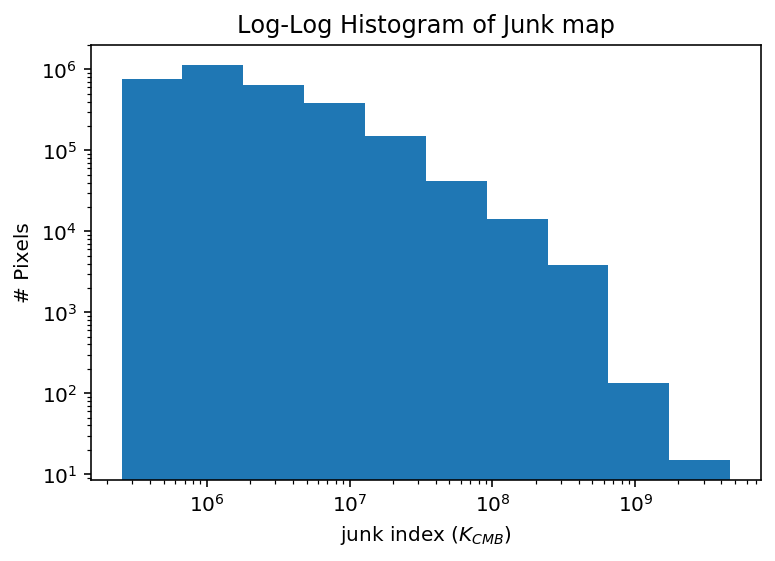

In [119]:
#finding the edges of our hist
number_bins = 11
low_edge = np.min(junk_map)
high_edge = np.max(junk_map)
log_bins = np.logspace(np.log10(low_edge),np.log10(high_edge), number_bins)

#plotting a log hist to find the regions
plt.hist(junk_map, bins=log_bins,log=True);
plt.title('Log-Log Histogram of Junk map')
plt.semilogx()
plt.xlabel('junk index ($K_{CMB}$)')
plt.ylabel('# Pixels')
print('the bin edges aka regions',log_bins)

In [120]:
#different region cuts
non_galax = np.logspace(np.log10(low_edge),np.log10(high_edge), 11)[:6]
galax = np.logspace(np.log10(non_galax[-1]),np.log10(high_edge), 9)
#galax_center = 
log_bins = np.concatenate((non_galax,galax[1:]))

In [121]:
#regions for the boolean mask making code
#grouping some of the larger bins together
#log_bins_modified = np.copy(log_bins)[:9]
#log_bins_modified[-1] = log_bins[-1]

regions = f.bins_to_regions(log_bins)
#regions = f.bins_to_regions([np.min(junk_map),np.max(junk_map)])
print(regions)

[[253673.751840287, 676377.9320346634], [676377.9320346634, 1803439.6550095784], [1803439.6550095784, 4808546.280446034], [4808546.280446034, 12821120.610807812], [12821120.610807812, 34185203.6207569], [34185203.6207569, 63100570.66914248], [63100570.66914248, 116473842.39518784], [116473842.39518784, 214992603.3701181], [214992603.3701181, 396842918.14666355], [396842918.14666355, 732510324.6089053], [732510324.6089053, 1352100166.3946598], [1352100166.3946598, 2495766678.702512], [2495766678.702512, 4606797240.830861]]


In [122]:

#boolean_template_temp = np.copy(boolean_template)
#vec = hp.ang2vec(np.pi / 2, np.pi * 2 / 4)
#print(vec)
#new_bool = []
#ipix_disc = hp.query_disc(nside=512, vec=vec, radius=np.radians(90))
#boolean_template_temp[1][ipix_disc] = True
#a = np.array([not i for i in boolean_template_temp[1]])
#b = np.array([not i for i in boolean_template_temp[0]])

new_bool.append(boolean_template_temp[0])
new_bool.append(np.logical_or(a,b))
new_bool.append(boolean_template_temp[1])


In [123]:
#splitting boolean map created from junk map
boolean_template, cut_junk_map = f.splitting_step1(regions,junk_map)
#boolean_template = new_bool

#code to use if you only want to see one region
#boolean_template, cut_junk_map = f.splitting_step1(np.array([[np.min(junk_map)-1, np.max(junk_map)+1]]),junk_map)

In [124]:
#cutting all maps
cuts = []

for i in range(len(CMB_maps)):
    cuts.append(f.splitting_step2(boolean_template, CMB_maps[i]))

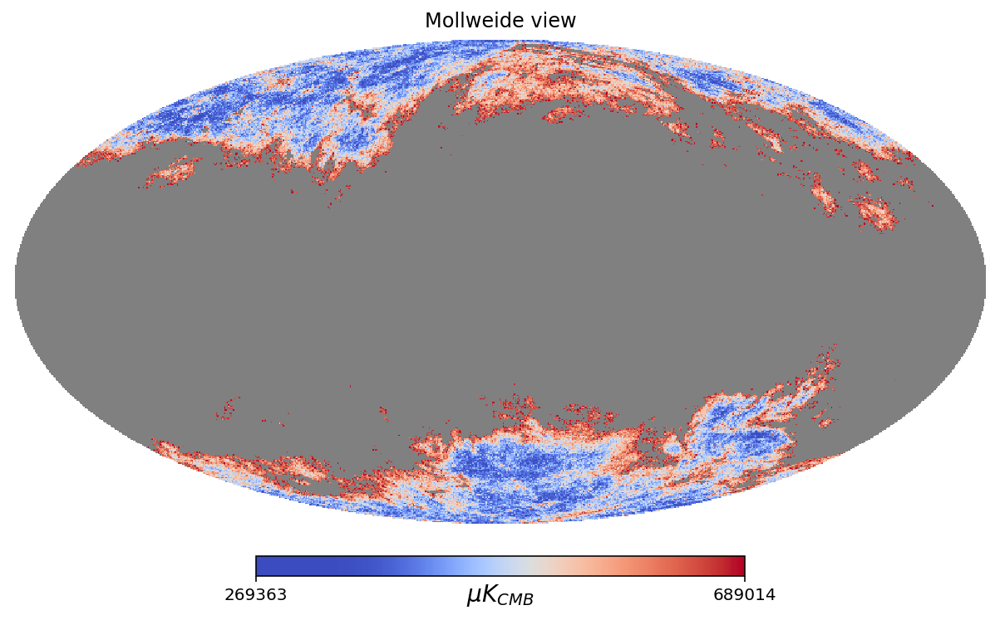

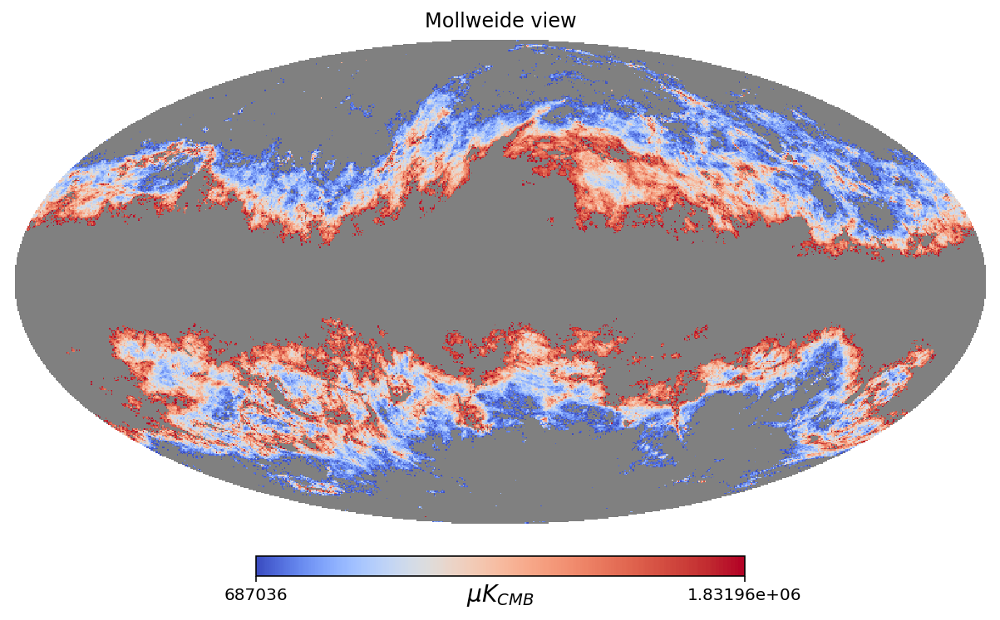

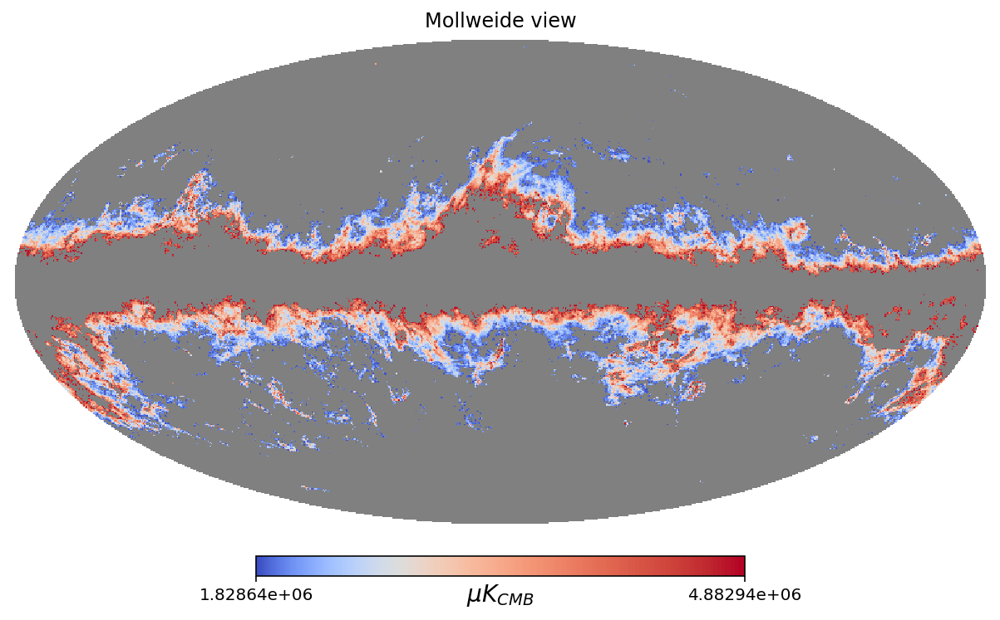

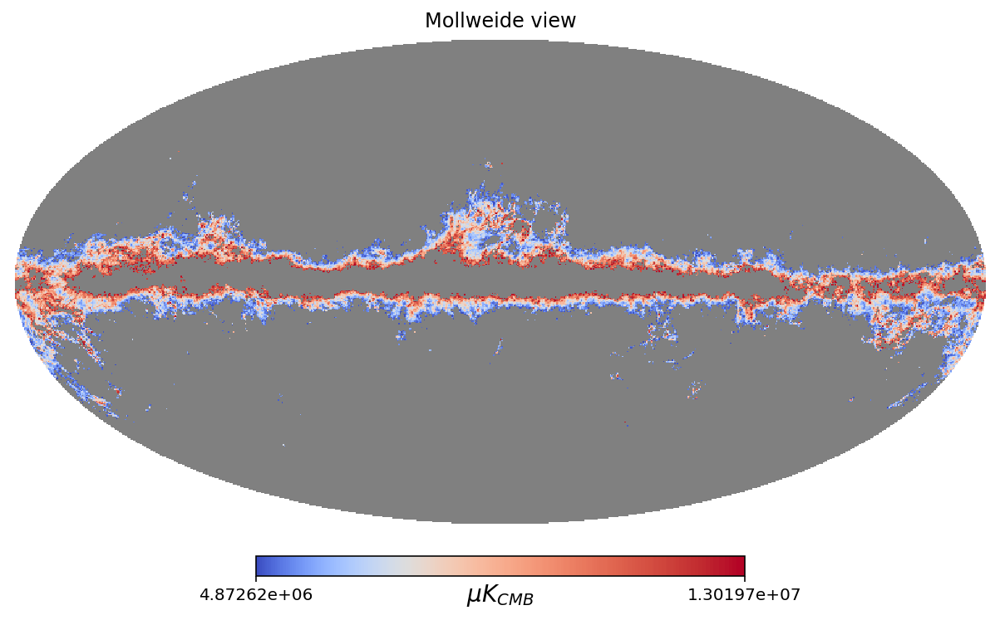

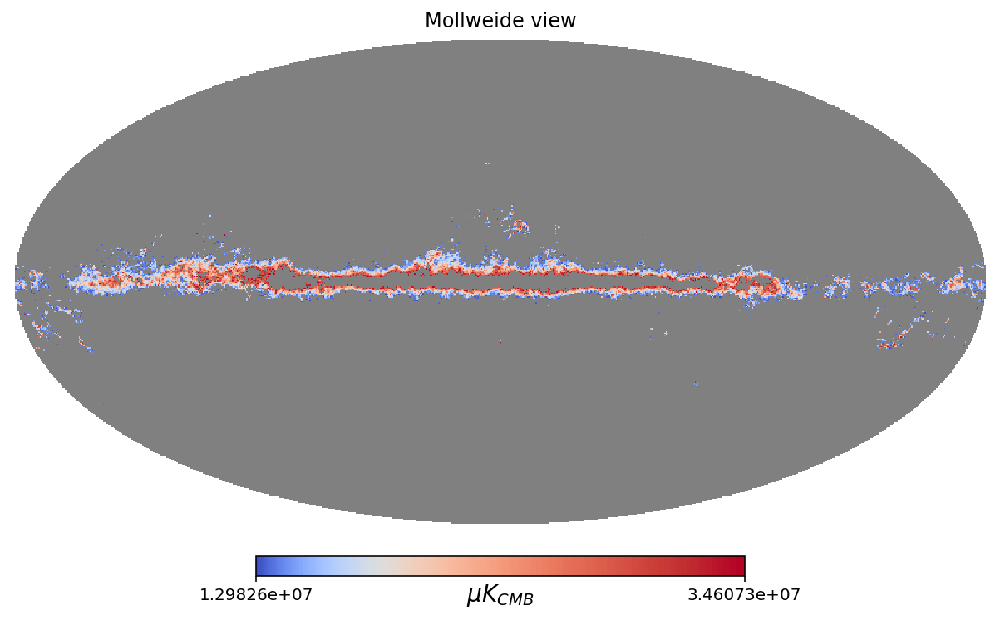

...

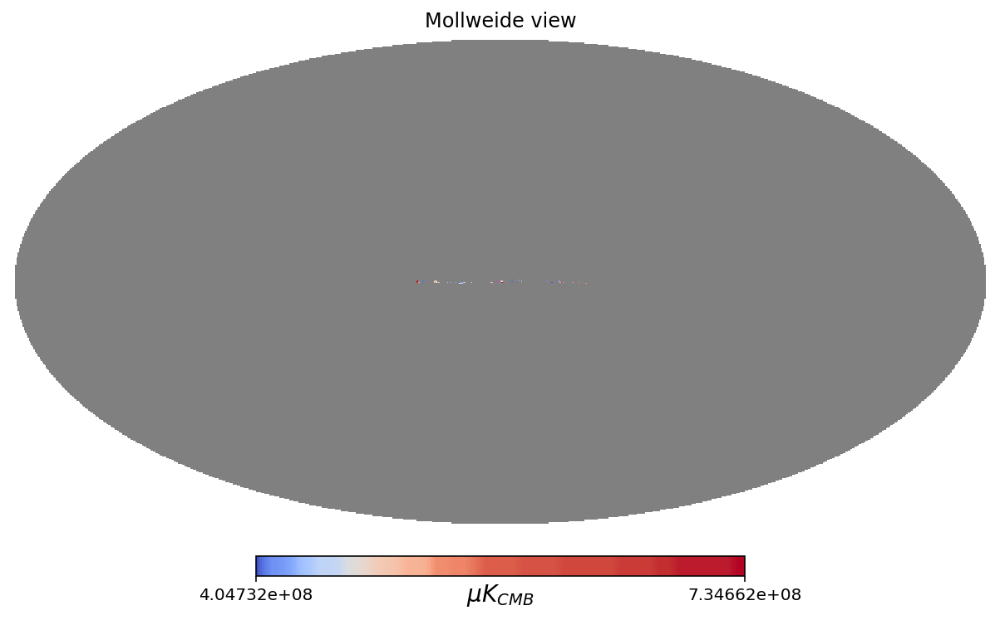

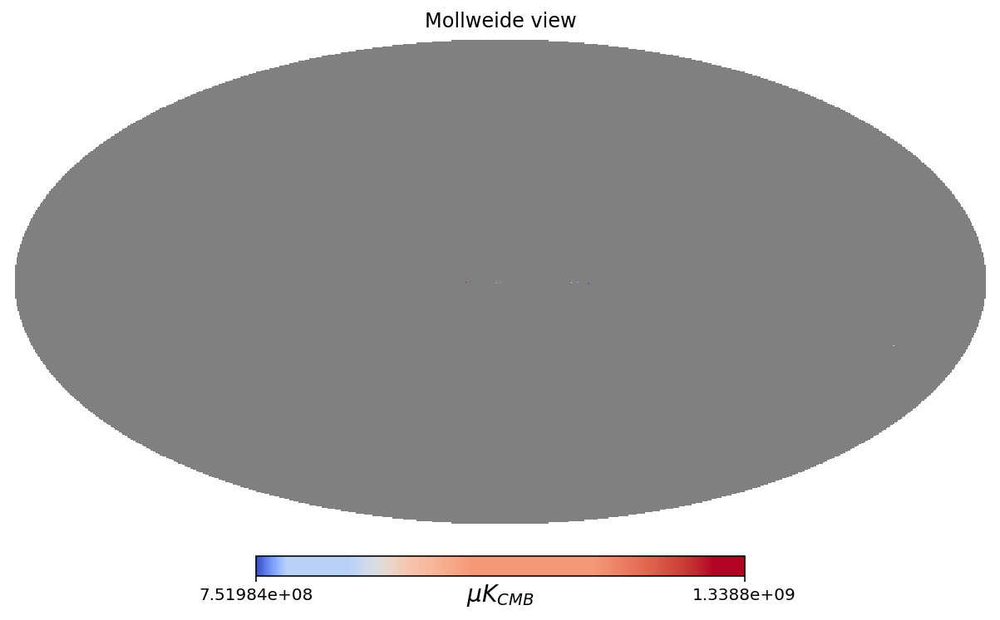

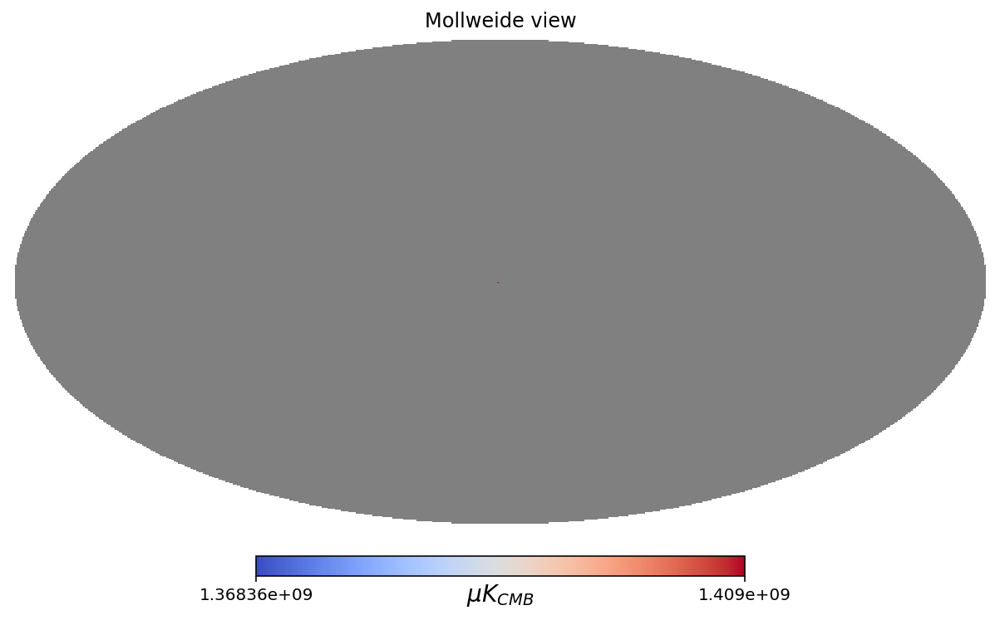

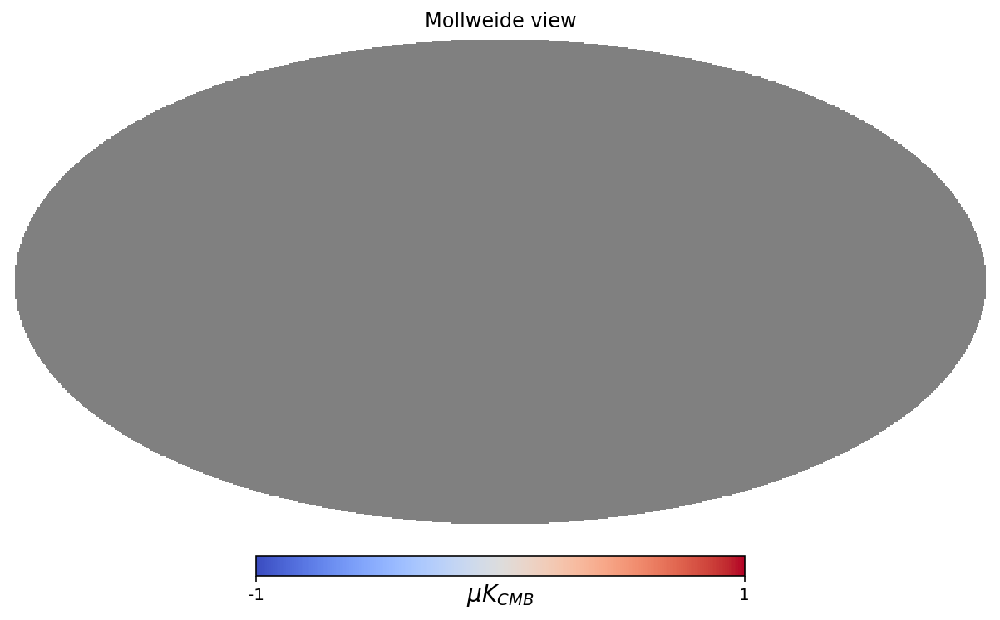

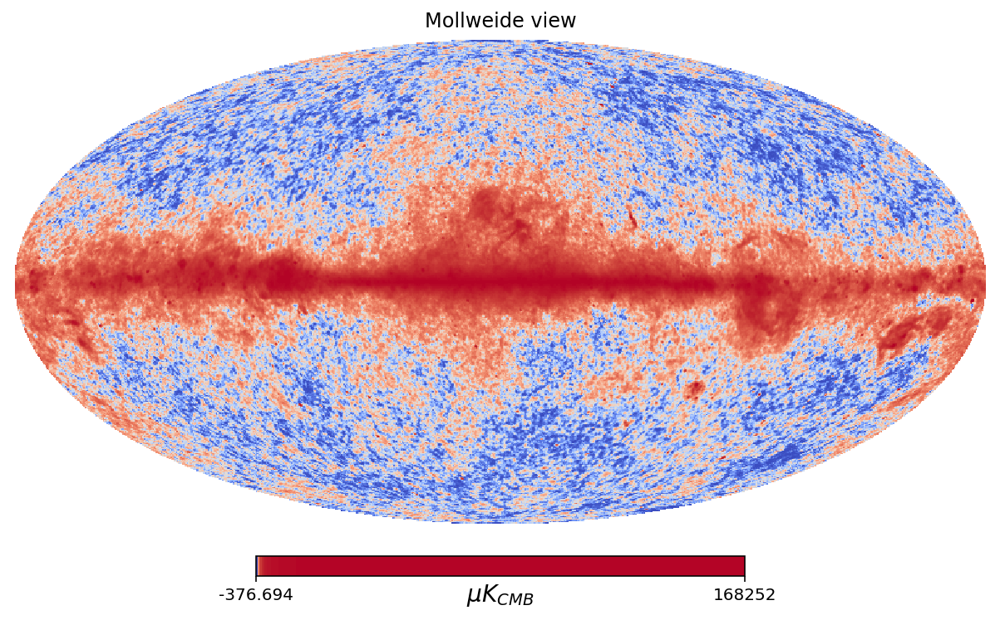

In [125]:
#visualizing the region splitting on the 30 GHz map
regions_vis = []
for i in range(len(boolean_template)):
    regions_vis.append(f.map_and_mask(boolean_template[i], CMB_maps[-1]))
    hp.mollview(regions_vis[-1], unit= u ,norm="hist", cmap = 'coolwarm')
hp.mollview( CMB_maps[0], unit= u ,norm="hist", cmap = 'coolwarm')

In [163]:
#computing different weights for each region of the cut maps
weights = []
#cuts_region is an array of regions, where each region contains the data from each frequency channel
cuts_region = np.transpose(cuts)
for i in range(len(cuts_region)):
    weights.append(f.compute_weights(cuts_region[i]))

#code for weighting a single region
#weights = [f.compute_weights(cuts_region)]

In [164]:
#making the weighted maps for each region, but not yet cutting them up
uncut_weighted_regions = []
for i in range(len(weights)):
    uncut_weighted_regions.append(f.weight_freqs(weights[i], CMB_maps))

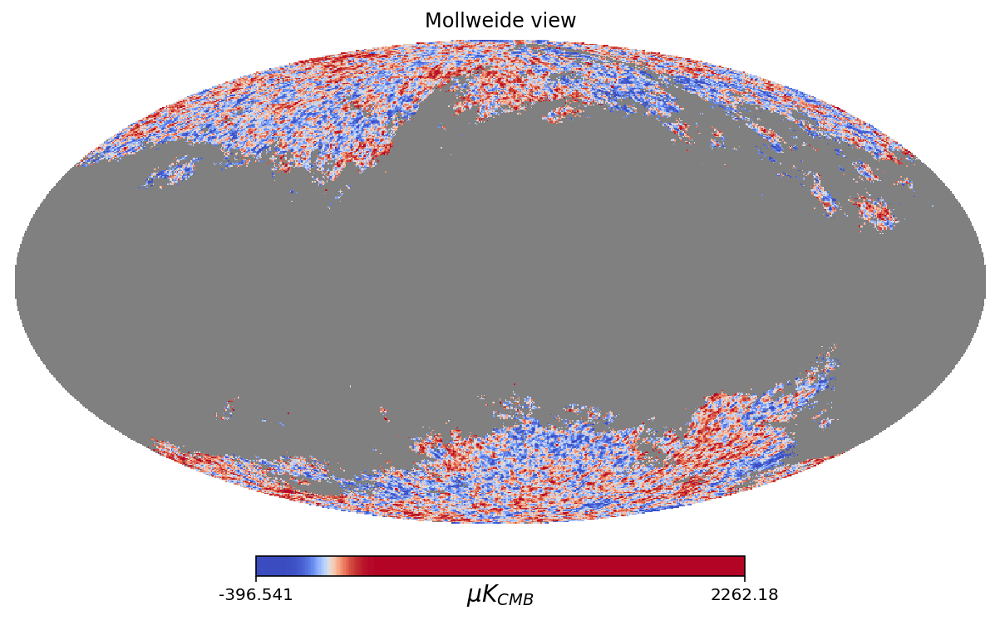

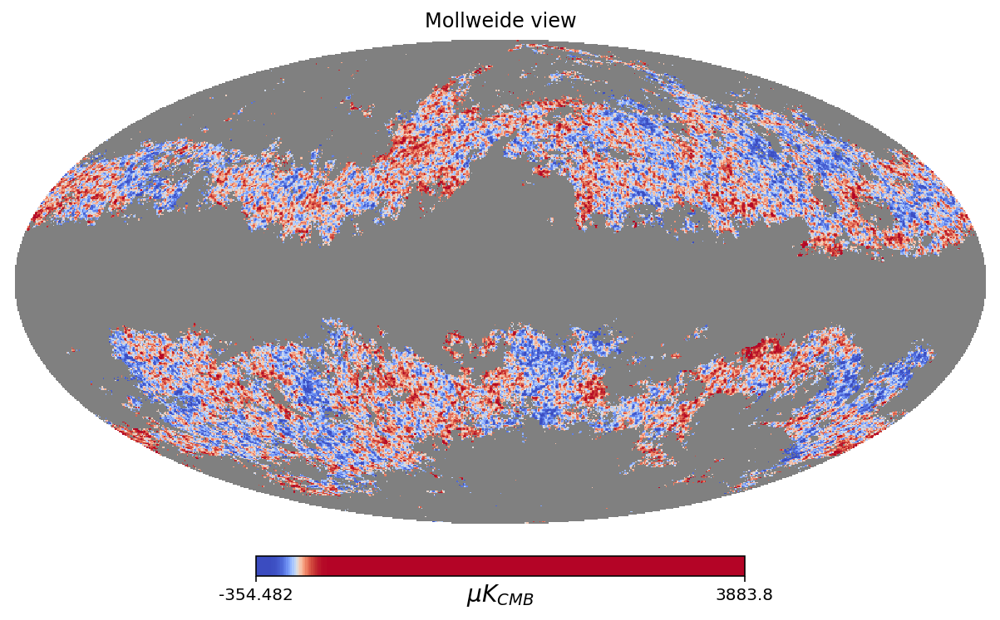

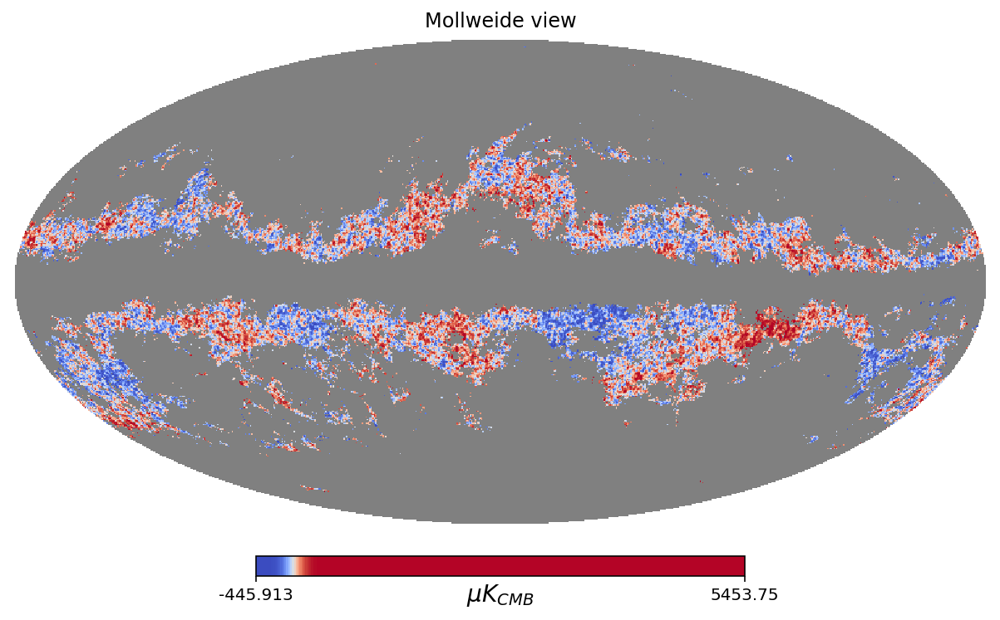

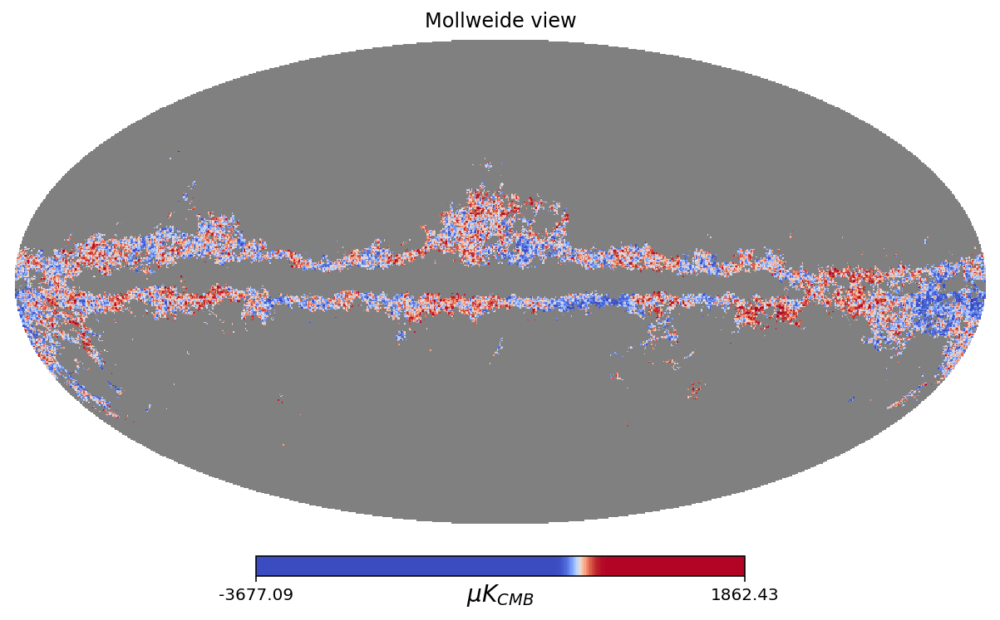

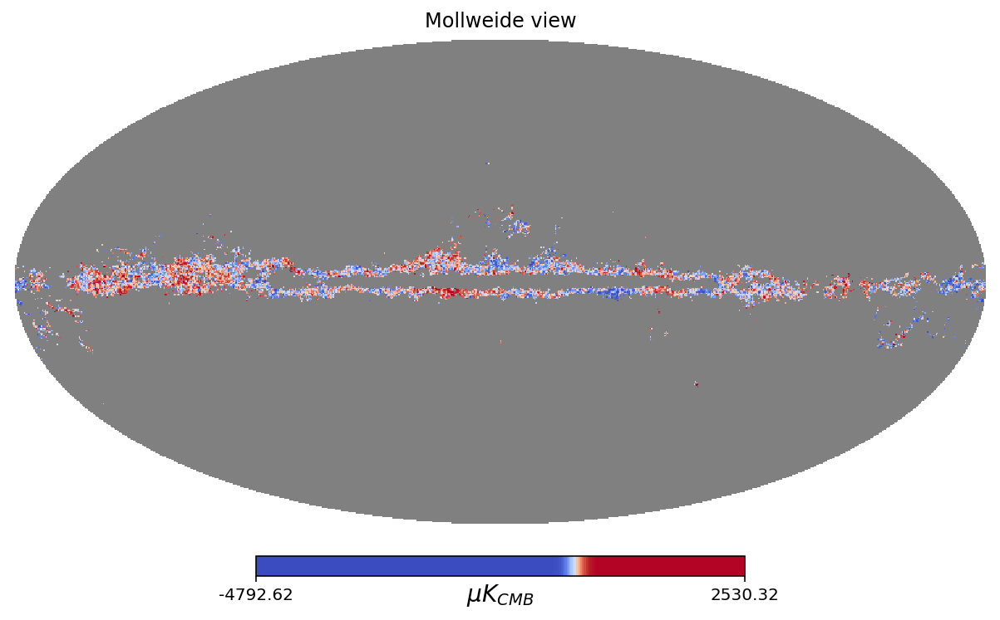

...

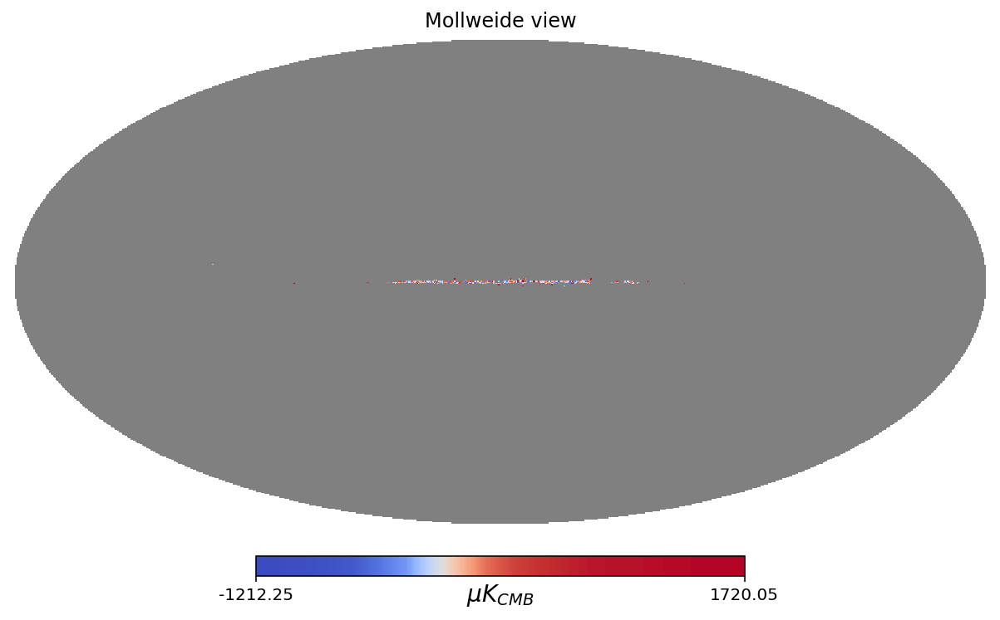

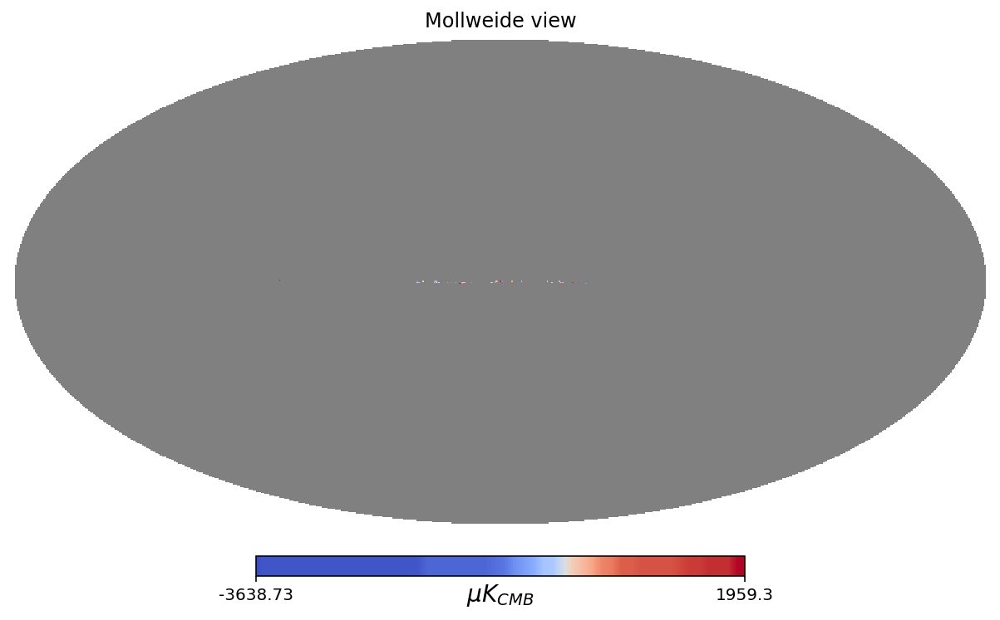

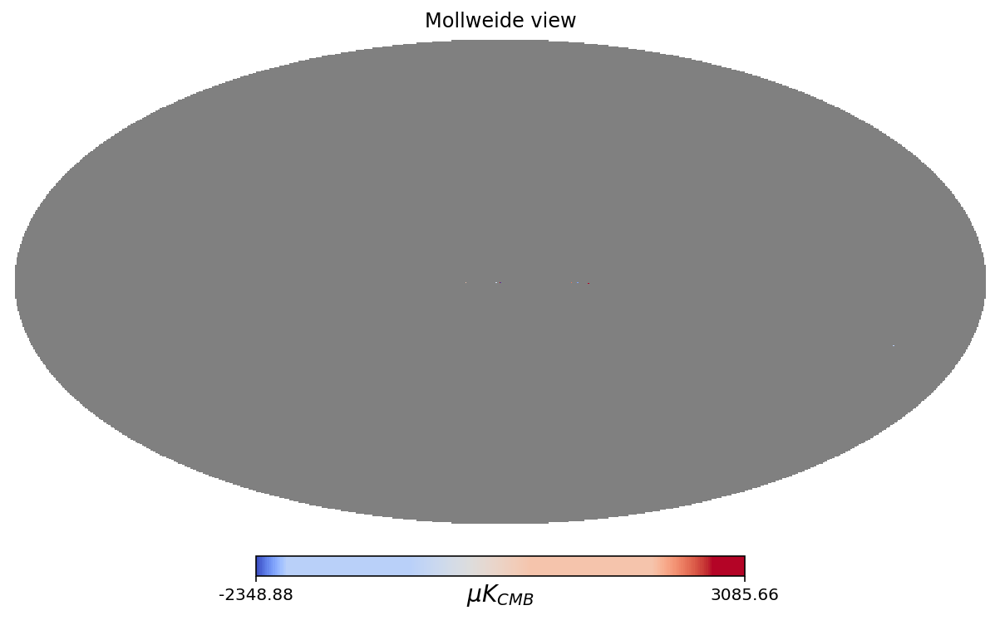

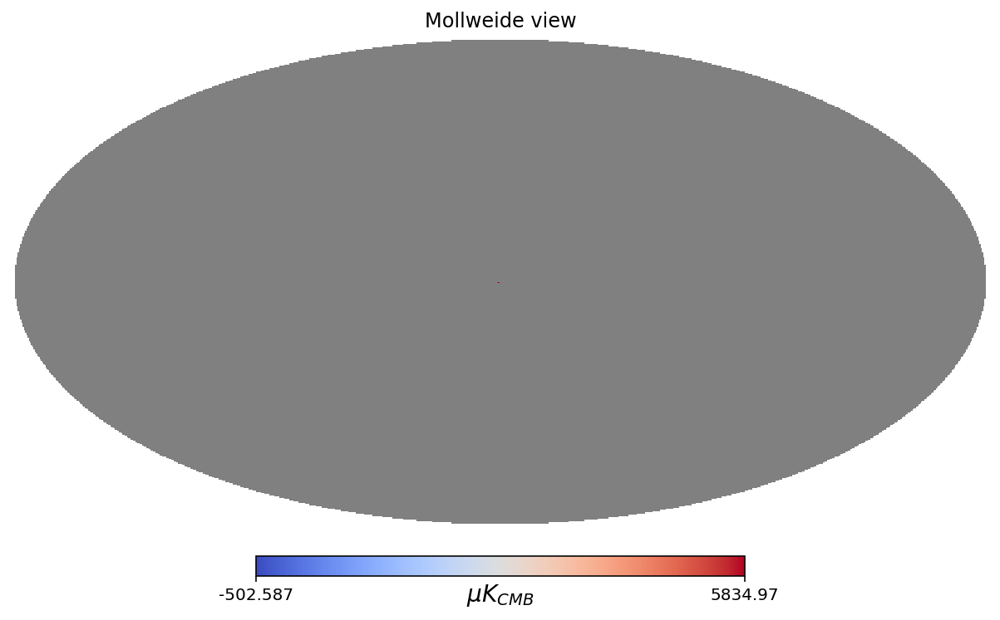

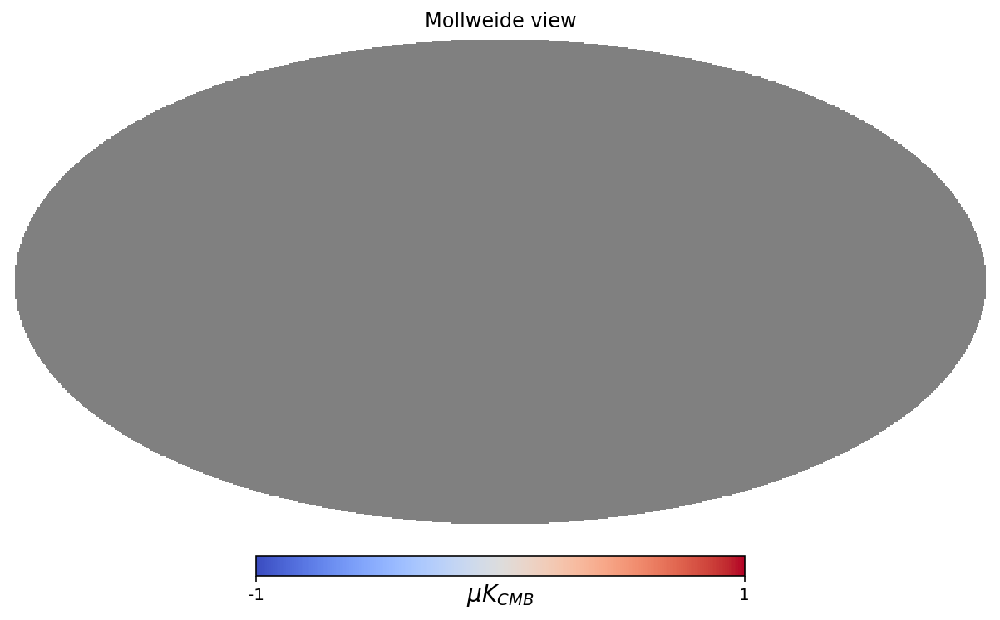

In [165]:
temp_map = []
for i in range(len(boolean_template)):
    temp_map = f.weight_freqs(weights[i], CMB_maps)
    to_plot = f.map_and_mask(boolean_template[i], temp_map)
    hp.mollview(to_plot,unit=u,norm="hist",cmap = 'coolwarm')

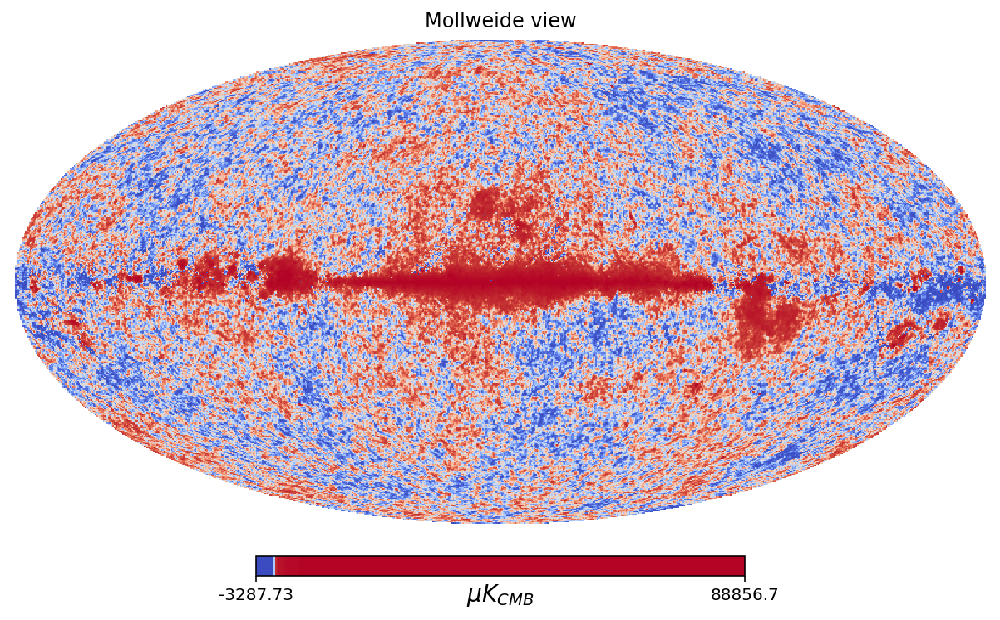

In [166]:
hp.mollview(uncut_weighted_regions[0],unit=u,norm="hist",cmap = 'coolwarm')

In [167]:
#setting the areas outside of regions to zero if the weights don't apply to that region and combining into one map
final_CMB_map = f.recombine_maps(uncut_weighted_regions, boolean_template)

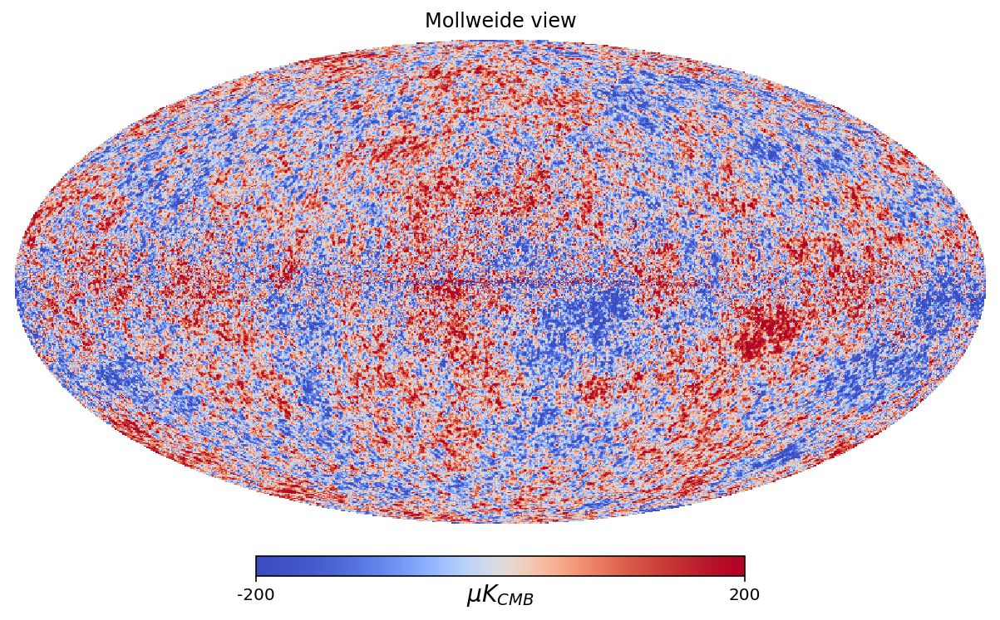

In [172]:
hp.mollview(final_CMB_map,min=-200,max=200, unit = r"$\mu K_{CMB}$",norm="hist", cmap = 'coolwarm')

In [50]:
final_CMB_map_smooth = f.recombine_maps_smoothly(uncut_weighted_regions, boolean_template)

Sigma is 12.739827 arcmin (0.003706 rad) 
-> fwhm is 30.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin
Sigma is 12.739827 arcmin (0.003706 rad) 
-> fwhm is 30.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin
Sigma is 12.739827 arcmin (0.003706 rad) 
-> fwhm is 30.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin
Sigma is 12.739827 arcmin (0.003706 rad) 
-> fwhm is 30.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin
Sigma is 12.739827 arcmin (0.003706 rad) 
-> fwhm is 30.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin
Sigma is 12.739827 arcmin (0.003706 rad) 
-> fwhm is 30.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin
Sigma is 12.739827 arcmin (0.003706 rad) 
-> fwhm is 30.000000 arcmin
Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin


KeyboardInterrupt: 

In [ ]:
hp.mollview(final_CMB_map_smooth, unit = u,norm="hist", cmap = 'coolwarm')

In [134]:
np.sum([2*i-1 for i in range(1024)])

1046528

In [150]:
np.sum([2*i+1 for i in range(1024)])

1048576

In [152]:
c = hp.anafast(CMB_maps[0], map2 = CMB_maps[1], lmax = 1024)

In [156]:
c

array([ 7.10888495e+05,  7.61810228e+04,  1.15851482e+05, ...,
       -1.61333445e-04, -2.38672611e-05, -8.19573570e-06])

In [159]:
def compute_Cl(CMB_maps):
    n = len(CMB_maps)
    c = np.empty((n,n))
    
    for i in range(n):
        for j in range(i, n - i):
            print(i,j)
            c[i][j] = hp.anafast(CMB_maps[i], map2 = CMB_maps[j], lmax = 1024)
            if(not (i==j)):
                c[j][i] = c[i][j]
    return(c)

In [160]:
c = compute_Cl(CMB_maps)

0 0


ValueError: setting an array element with a sequence.